Tutorial de https://davidkebo.com/cudd , hecho con ctypes

1) Preparo el entorno: biblioteca cudd so, declaraciones de tipo, funciones de utilidad

    1.1) compilo la so (lo hago con el terminal en vez de este notebook). Como dice el readme de cudd-3.0.0, con una opción de configure

    ./configure --enable-shared

    He tenido que hacer antes make clean. copio el \*.so en este directorio (no el hardlink, el fichero, cambiando el trailing 0.0.0)
    
    1.2) me hace falta las structs replicadas. Lo hago con ctypesgen:
    
    /home/juanlu/anaconda3/bin/ctypesgen -llibcudd-3.0.0.so cudd.h -o cudd.py
    
    1.3) Los tipos de vuelta no los especifica, sin embargo. Los añado a mano.
    
    1.4) funciones de utilidad:
        - print_dd
        - write_dd
        - crear a partir de tabla de verdad
        - añadir un cubo

In [1]:
%%bash
#1.1)  comentado por seguridad
# make clean
# ../../cudd-3.0.0/configure --enable-shared
# make
# cp ../tutorial2/cudd-3.0.0/cudd/.libs/libcudd.so .

In [1]:
%%bash
#1.2)
#cp ../../cudd-3.0.0/cudd/cudd.h .
#quitarcoment# ctypesgen -llibcudd-3.0.0.so cudd.h -o cudd.py

# Está lleno de errores. Quizá por eso tengo que especificar luego a mano. Hay que ver en detalle

In [1]:
%run -i cudd.py
# el espacio de nombres queda algo polucionado:

# aparte ¿es realmente necesario?  Si, defines DdManager DdNode, etc

In [2]:
#from ctypes import *  <--mejor esto no
import ctypes
libcudd = ctypes.CDLL("./libcudd-3.0.0.so")

In [3]:
#1.3)
libcudd.Cudd_Init.restype = POINTER(DdManager)
libcudd.Cudd_ReadOne.restype = POINTER(DdNode)
libcudd.Cudd_Ref.argtypes = POINTER(DdNode),
libcudd.Cudd_Ref.restype = None
libcudd.Cudd_bddIthVar.restype = POINTER(DdNode)
libcudd.Cudd_CubeArrayToBdd.restype = POINTER(DdNode)
libcudd.Cudd_RecursiveDeref.argtypes = POINTER(DdManager), POINTER(DdNode)
libcudd.Cudd_RecursiveDeref.restype = None
libcudd.Cudd_BddToAdd.restype = POINTER(DdNode)
#libcudd.Cudd_PrintDebug.restype
#libcudd.Cudd_DumpDot.restype = 
libcudd.Cudd_bddOr.argtypes = POINTER(DdManager), POINTER(DdNode), POINTER(DdNode)
libcudd.Cudd_bddOr.restype = POINTER(DdNode)

libcudd.Cudd_ReduceHeap.argtypes = POINTER(DdManager), Cudd_ReorderingType , ctypes.c_int 
libcudd.Cudd_ReduceHeap.restype = ctypes.c_int 
libcudd.Cudd_CheckZeroRef.argtypes = POINTER(DdManager),
libcudd.Cudd_addBddPattern.argtypes = POINTER(DdManager), POINTER(DdNode)
libcudd.Cudd_addBddPattern.restype = POINTER(DdNode)

In [7]:
Cudd_ReorderingType 

ctypes.c_int

In [8]:
gbm = libcudd.Cudd_Init(0,0,CUDD_UNIQUE_SLOTS,CUDD_CACHE_SLOTS,0) #/* Initialize a new BDD manager. */

In [9]:
bdd = libcudd.Cudd_ReadOne(gbm)
libcudd.Cudd_Ref(bdd)

In [10]:
for i in range(0,8):
    libcudd.Cudd_bddIthVar(gbm,i)

In [43]:
miarr_py = [ 0,1 , 0,1,1,0,0,1]
# truco de https://stackoverflow.com/questions/4145775/how-do-i-convert-a-python-list-into-a-c-array-by-using-ctypes
miarr_c = (ctypes.c_int * len(miarr_py))(*miarr_py)
tmp = libcudd.Cudd_CubeArrayToBdd(gbm, byref(miarr_c))
libcudd.Cudd_Ref(tmp);
libcudd.Cudd_RecursiveDeref(gbm,bdd);
bdd = tmp;

In [12]:
libcudd.Cudd_PrintDebug(gbm, bdd, 2, 4)
# la salida en el term que llamó a jupyter

1

Esto no!!
# de https://stackoverflow.com/questions/17257137/using-python-ctypes-and-libc-to-write-void-pointer-to-binary-file/17257911#17257911

libc = ctypes.cdll.LoadLibrary('libc.so.6')

fopen = libc.fopen
fopen.argtypes = ctypes.c_char_p, ctypes.c_char_p,
fopen.restype = ctypes.c_void_p

fwrite = libc.fwrite
fwrite.argtypes = ctypes.c_void_p, ctypes.c_size_t, ctypes.c_size_t, ctypes.c_void_p
fwrite.restype = ctypes.c_size_t

fclose = libc.fclose
fclose.argtypes = ctypes.c_void_p,
fclose.restype = ctypes.c_int


In [14]:
libBDDlab = ctypes.CDLL("./BDDlab/libBDDlab.so")

In [14]:
libBDDlab.print_dd.argtypes = POINTER(DdManager), POINTER(DdNode), ctypes.c_int, ctypes.c_int
# (DdManager *gbm, DdNode	*dd, int n, int pr )

libBDDlab.write_dd.argtypes = POINTER(DdManager), POINTER(DdNode), ctypes.c_char_p
#(DdManager *gbm, DdNode	*dd, char* filename)


In [15]:
libBDDlab.print_dd(gbm, bdd, 2,4)
libBDDlab.write_dd(gbm, bdd, b'elgrafo.dot')


0

In [16]:
%%bash
dot -Tpng ./elgrafo.dot > ./elgrafo.png

In [66]:
from IPython.display import Image, display

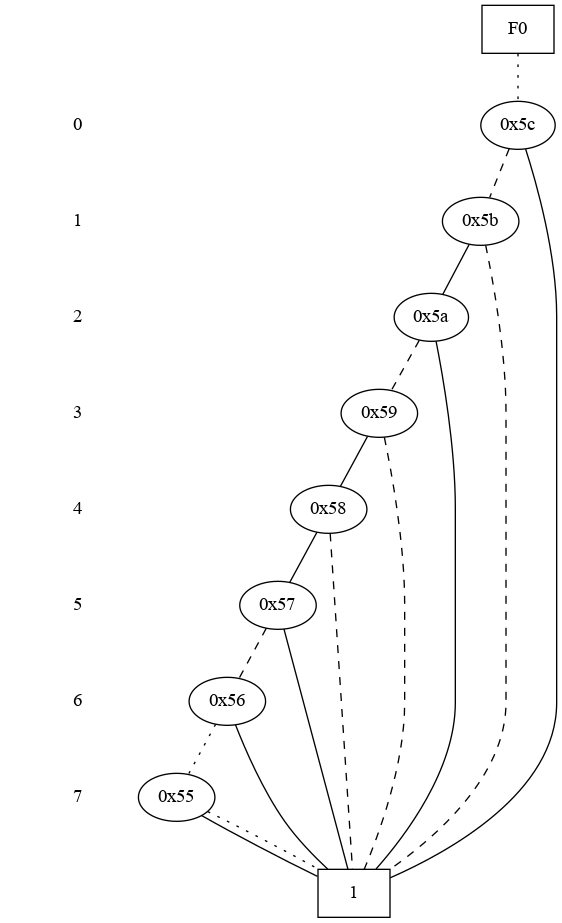

In [18]:
Image(filename='./elgrafo.png')

In [38]:
#ver si está bien bdd:
libcudd.Cudd_CheckZeroRef(gbm)

224

In [39]:
libcudd.Cudd_RecursiveDeref(gbm,bdd)
libcudd.Cudd_CheckZeroRef(gbm)

224

In [40]:
libcudd.Cudd_Quit(gbm)

0

Ahora unos minterns al azar:

In [21]:
import random

In [22]:
numMinterm = 308
for j in range(0, numMinterm -1) :
    miarr_py = [random.randint(0,1) for i in range(0,8)]
    miarr_c = (ctypes.c_int * len(miarr_py))(*miarr_py)
    tmp = libcudd.Cudd_CubeArrayToBdd(gbm, byref(miarr_c))
    libcudd.Cudd_Ref(tmp)
    #libcudd.Cudd_RecursiveDeref(gbm,bdd)
    tmp2 = libcudd.Cudd_bddOr(gbm, tmp, bdd)
    libcudd.Cudd_Ref(tmp2)
    libcudd.Cudd_RecursiveDeref(gbm,tmp)
    libcudd.Cudd_RecursiveDeref(gbm,bdd)
    bdd = tmp2
    #libcudd.Cudd_RecursiveDeref(gbm,tmp2)
    

In [16]:
#ver si está bien bdd:
libcudd.Cudd_CheckZeroRef(gbm)

236

In [24]:
#libcudd.Cudd_RecursiveDeref(gbm,bdd)
#libcudd.Cudd_CheckZeroRef(gbm)

In [13]:
from IPython.display import Image

In [26]:
libBDDlab.write_dd(gbm, bdd, b'elgrafo.dot')

0

In [27]:
libBDDlab.print_dd(gbm,bdd,2,4)


1

In [28]:
%%bash
dot -Gsize='50x50' -Tpng ./elgrafo.dot > ./elgrafo.png

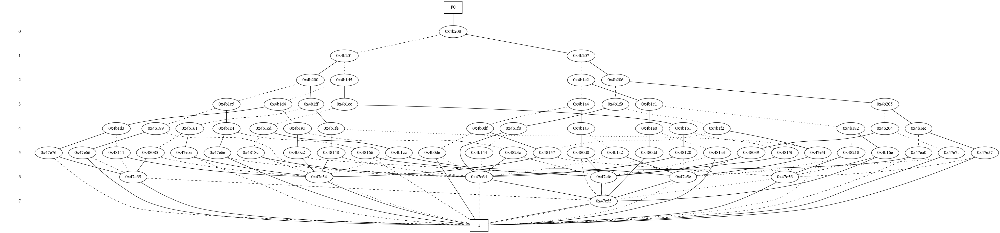

In [29]:
Image(filename='./elgrafo.png')

Reordenar

In [16]:
#ver si está bien bdd:
libcudd.Cudd_CheckZeroRef(gbm)

266

In [24]:
libcudd.cuddHeapProfile(gbm)

1

In [18]:
libcudd.Cudd_RecursiveDeref(gbm,bdd)
libcudd.Cudd_CheckZeroRef(gbm)

2

In [19]:
libcudd.Cudd_Quit(gbm)

0

In [41]:
#t=libcudd.Cudd_ReduceHeap(gbm, CUDD_REORDER_EXACT, 1)
#libcudd.Cudd_ReduceHeap(gbm, CUDD_REORDER_NONE, 1) #<...este funciona
#libcudd.Cudd_ReduceHeap(gbm, CUDD_REORDER_EXACT, 1)
libcudd.Cudd_ReduceHeap(gbm, CUDD_REORDER_SIFT, 1)

1

In [37]:
#bdd = libcudd.Cudd_BddToAdd(gbm, bdd)

In [42]:
libBDDlab.write_dd(gbm, bdd, b'elgrafoReorder.dot')

0

In [43]:
%%bash
dot -Gsize='50x50' -Tpng ./elgrafoReorder.dot > ./elgrafoReorder.png

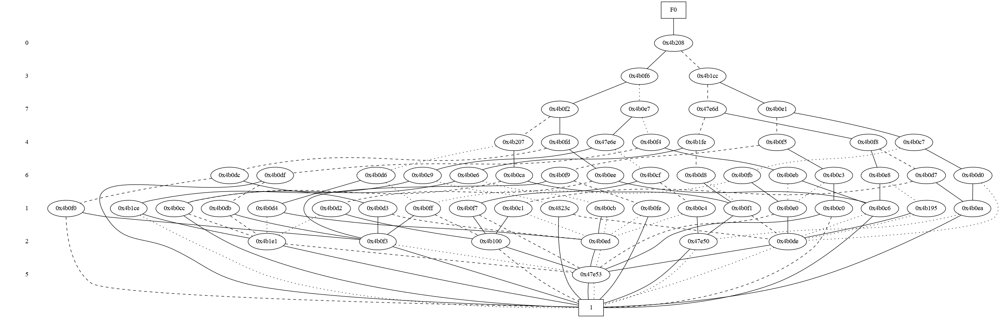

In [44]:
Image(filename='./elgrafoReorder.png')

O sea, me como el coco, y al final funciona no sé como. Lo de poner tmp2 creo que aclara

https://stackoverflow.com/questions/62663100/cudd-bdds-building-a-boolean-as-disjunction-of-conjunctions-but-get-runtime-err

In [51]:
reordenes =[CUDD_REORDER_SAME,
    CUDD_REORDER_NONE,
    CUDD_REORDER_RANDOM,
    CUDD_REORDER_RANDOM_PIVOT,
    CUDD_REORDER_SIFT,
    CUDD_REORDER_SIFT_CONVERGE,
    CUDD_REORDER_SYMM_SIFT,
    CUDD_REORDER_SYMM_SIFT_CONV,
    CUDD_REORDER_WINDOW2,
    CUDD_REORDER_WINDOW3,
    CUDD_REORDER_WINDOW4,
    CUDD_REORDER_WINDOW2_CONV,
    CUDD_REORDER_WINDOW3_CONV,
    CUDD_REORDER_WINDOW4_CONV,
    CUDD_REORDER_GROUP_SIFT,
    CUDD_REORDER_GROUP_SIFT_CONV,
    CUDD_REORDER_ANNEALING,
    CUDD_REORDER_GENETIC,
    CUDD_REORDER_LINEAR,
    CUDD_REORDER_LINEAR_CONVERGE,
    CUDD_REORDER_LAZY_SIFT,
    CUDD_REORDER_EXACT]

In [ ]:
for orden in reordenes:
    libcudd.Cudd_ReduceHeap(gbm, orden, 1)
    libBDDlab.write_dd(gbm, bdd, b'elgrafo' +str(orden).encode() +b'.dot')
    os.system("dot -Gsize='50x50' -Tpng ./elgrafo" +str(orden)+ ".dot > ./elgrafo" +str(orden)+ ".png")
    

0


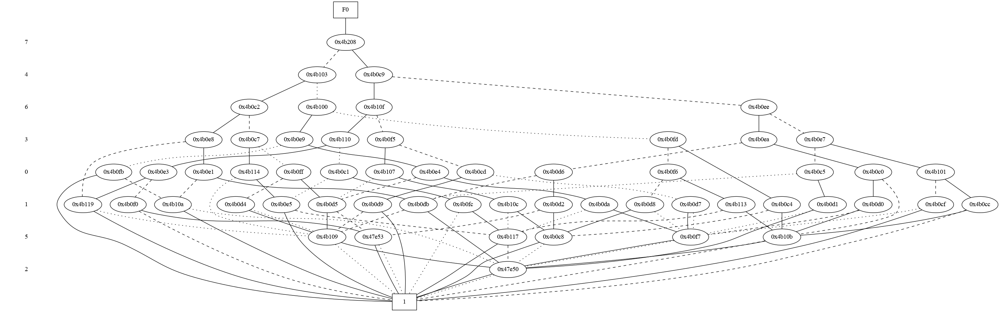

1


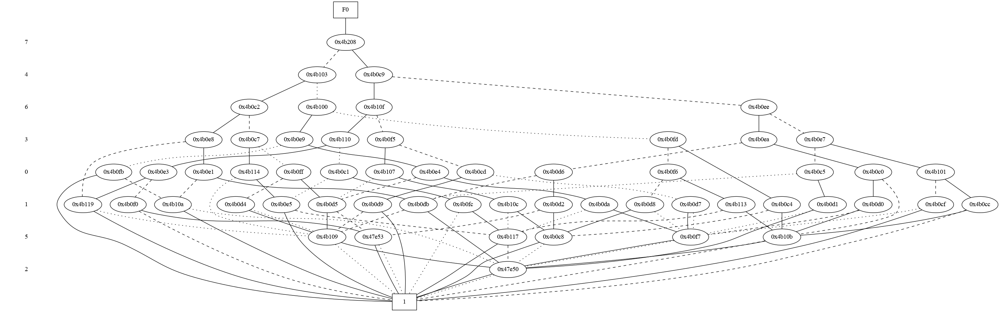

2


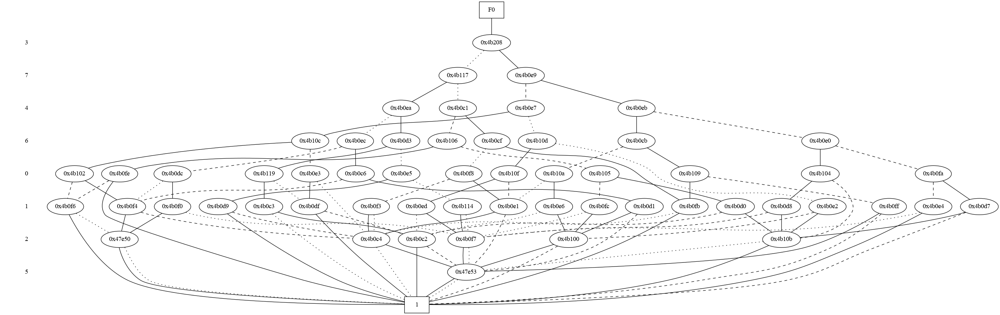

3


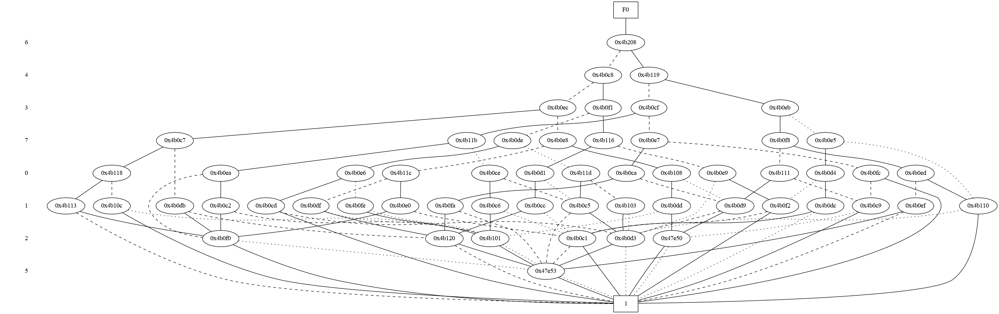

4


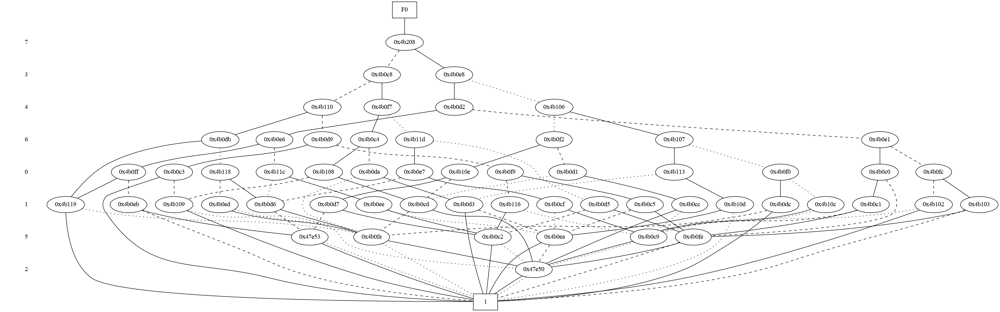

5


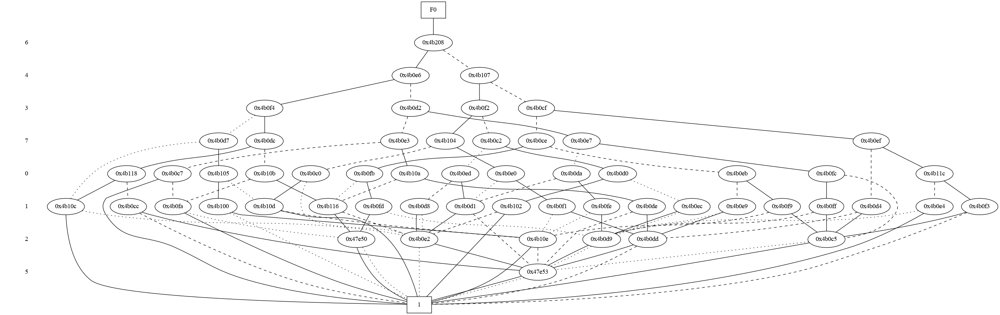

6


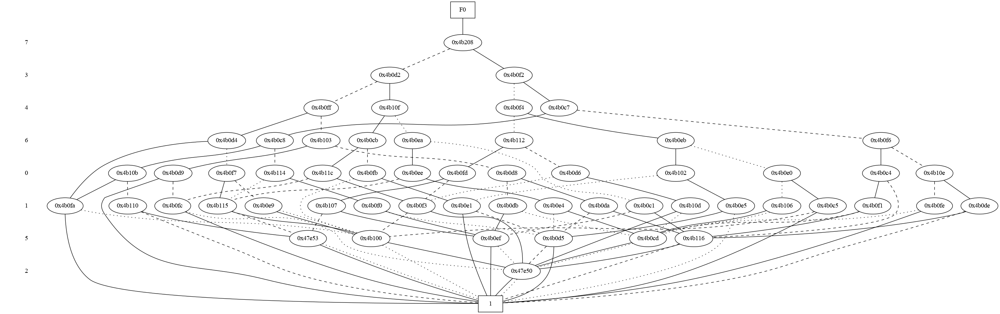

7


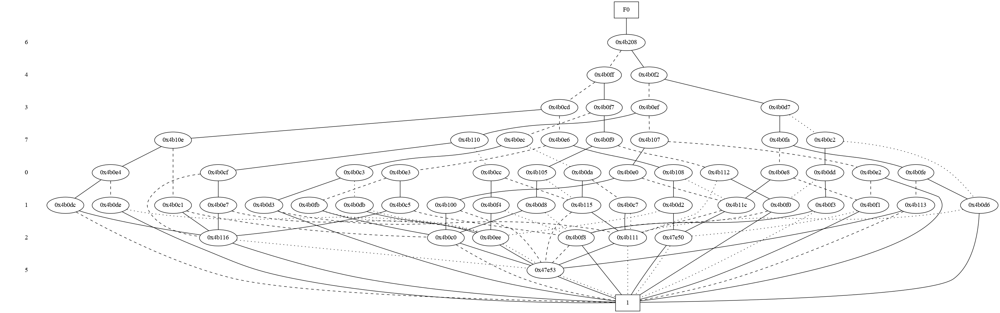

8


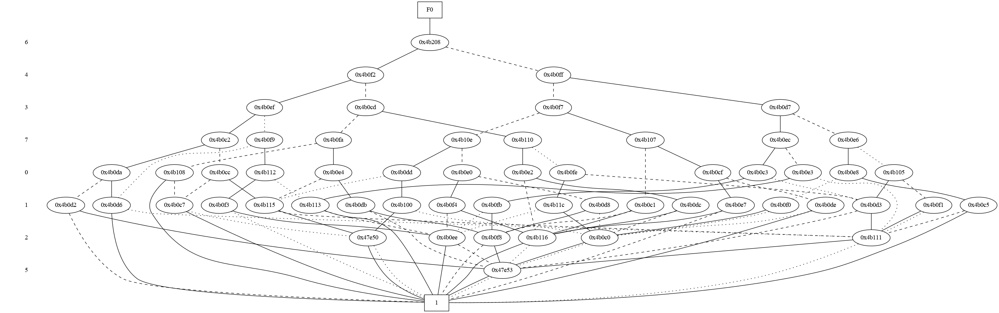

9


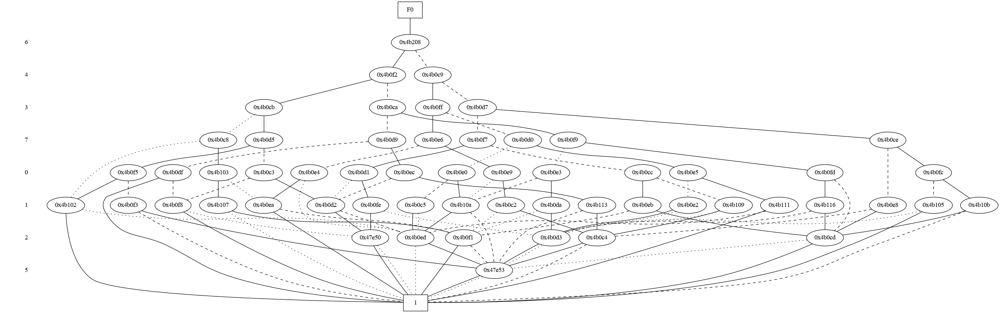

10


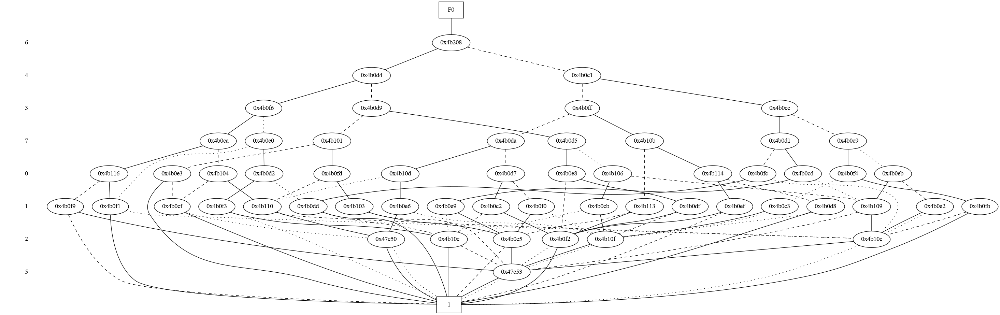

11


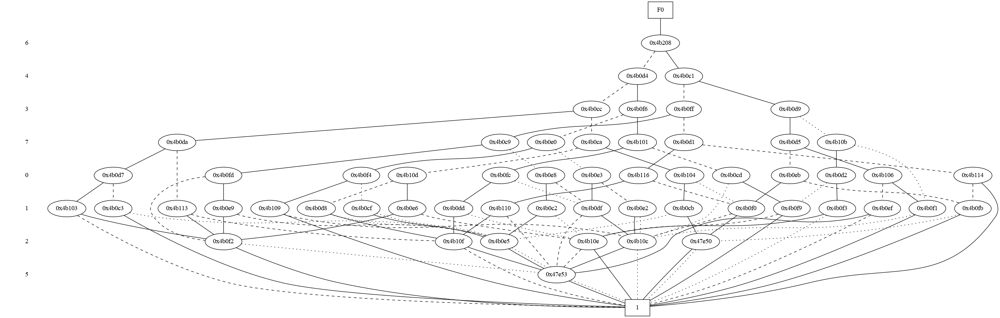

12


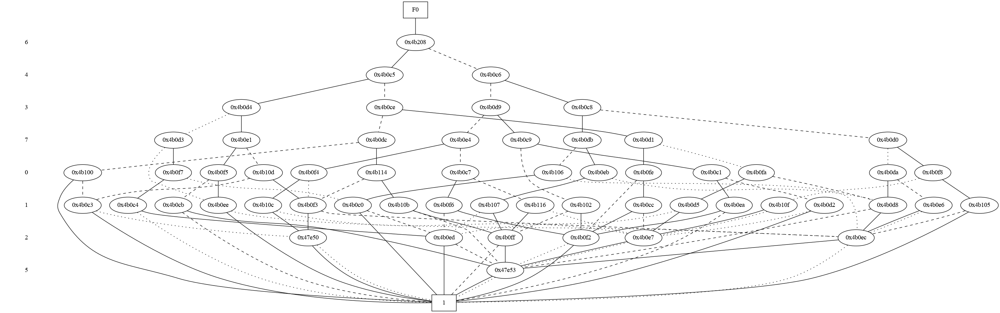

13


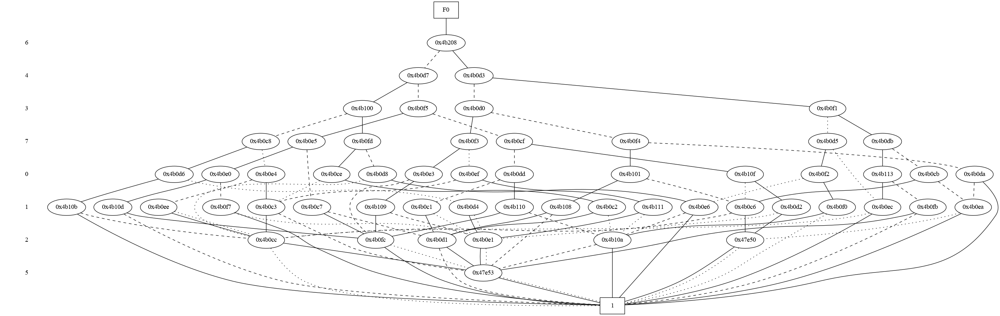

14


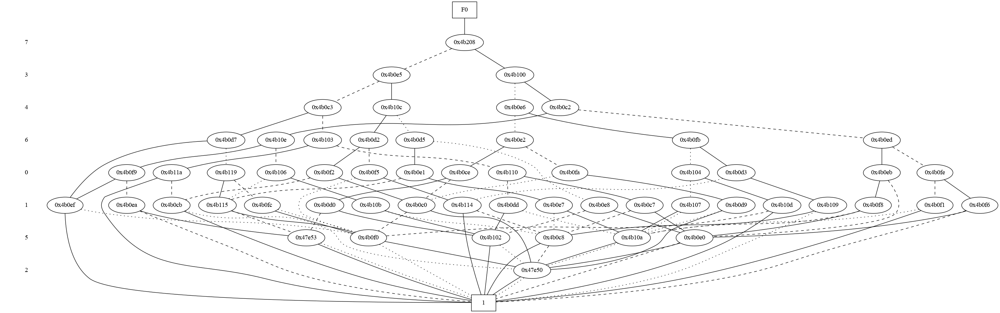

15


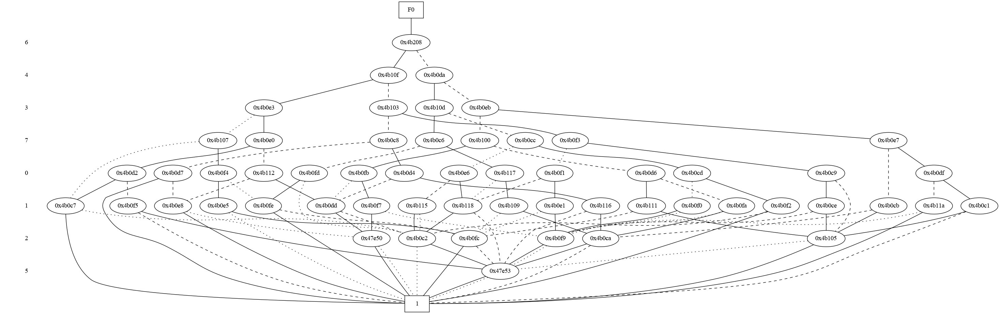

16


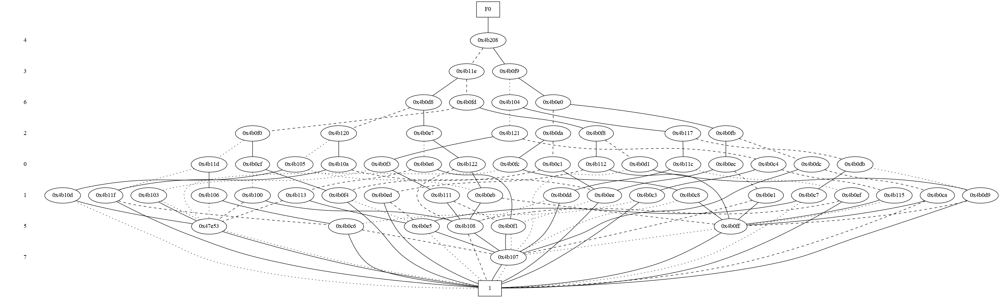

17


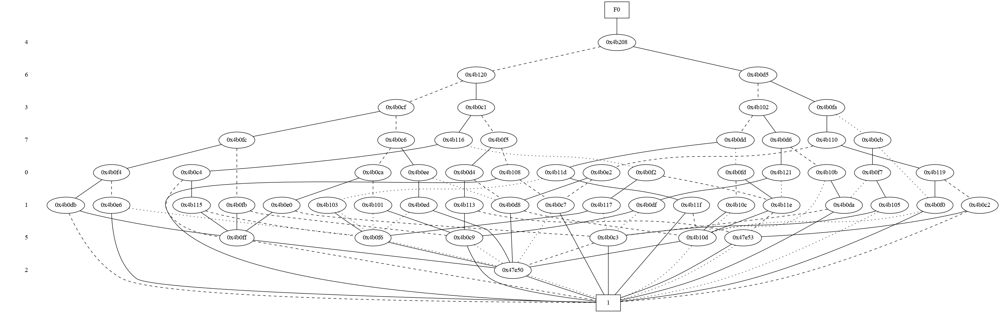

18


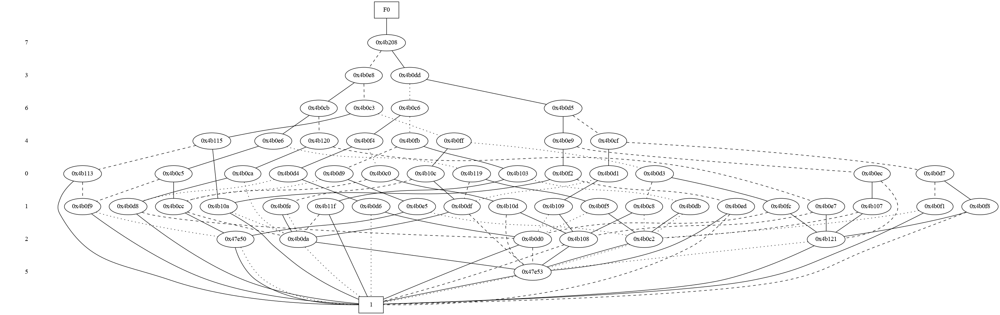

19


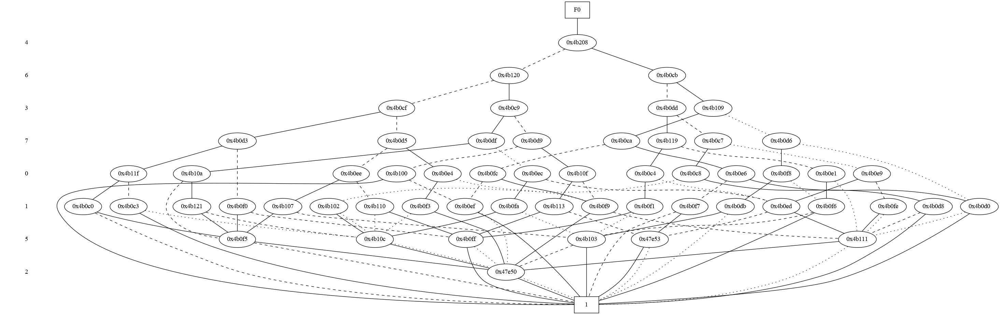

20


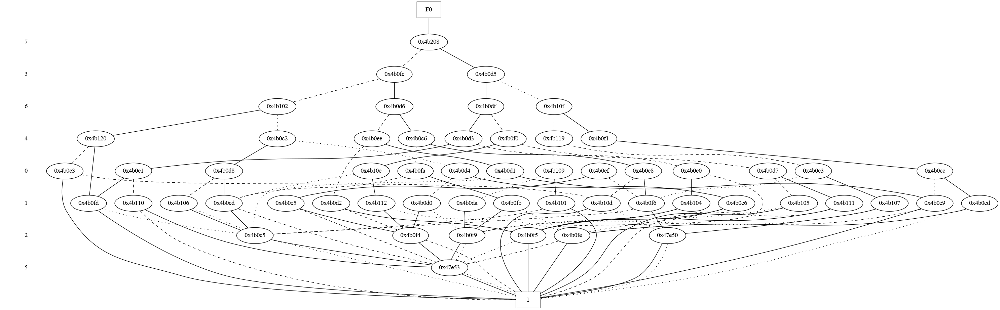

21


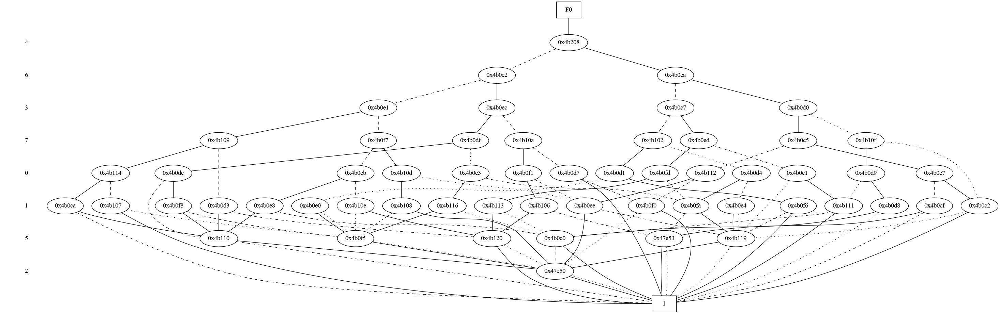

In [76]:
for orden in reordenes:
    print(orden)
    display(Image(filename='./elgrafo' +str(orden)+ '.png', width=1000, unconfined=True))


In [85]:
libcudd.Cudd_bddPermute.argtypes = [POINTER(DdManager), POINTER(DdNode), POINTER(c_int)]
libcudd.Cudd_bddPermute.restype = POINTER(DdNode)

In [ ]:
outbdd = Cudd_bddPermute(bddMgr, inbdd, permutation);
Cudd_Ref(outbdd);
Cudd_RecursiveDeref(manager,inbdd);  <<<<< cuidadín, esto no lo hago

In [100]:
miarr_py = [3,2,1,0,4,5,6,7]
miarr_c = (ctypes.c_int * len(miarr_py))(*miarr_py)
outbdd = libcudd.Cudd_bddPermute(gbm,bdd, miarr_c)

In [101]:
miarr_py

[3, 2, 1, 0, 4, 5, 6, 7]

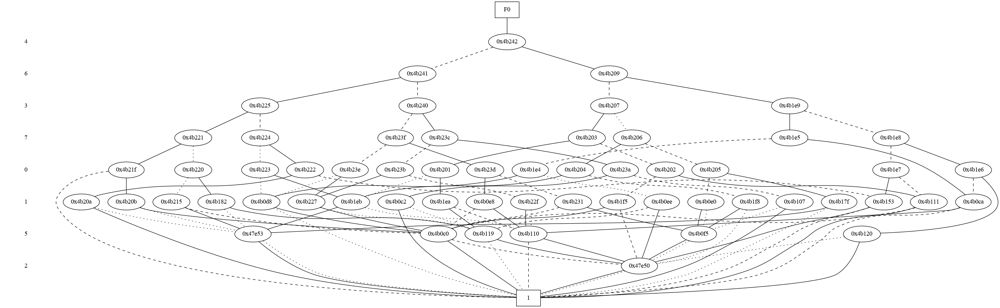

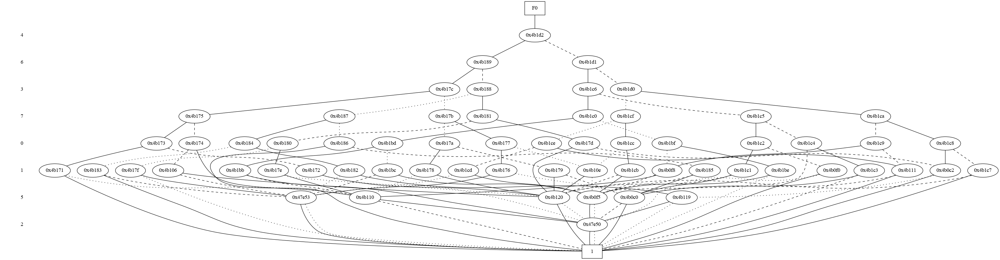

In [102]:
libBDDlab.write_dd(gbm, outbdd, b'tmp.dot')
os.system("dot -Gsize='50x50' -Tpng ./tmp.dot > ./tmp.png")
display(Image(filename='./tmp.png', width=1000, unconfined=True))
display(Image(filename='./tmp2.png', width=1000, unconfined=True))


Crear a partir de una tabla de verdad


In [20]:
gbm = libcudd.Cudd_Init(0,0,CUDD_UNIQUE_SLOTS,CUDD_CACHE_SLOTS,0) #/* Initialize a new BDD manager. */
bdd = libcudd.Cudd_ReadOne(gbm)
libcudd.Cudd_Ref(bdd)

In [21]:
tam=15
for i in range(0,tam):
    libcudd.Cudd_bddIthVar(gbm,i)

In [31]:
TablaVerdad = [0] * 2**tam
for i in range(int(2**tam/7)+1):  # quitar +1 para pot de 2
    TablaVerdad[i*7] = 1

In [22]:
import math
TablaVerdad = [0] * 2**tam
for i in range(int(math.sqrt(2**tam))):
    TablaVerdad[i*i] = 1

In [23]:
# ay, que esto es necesario al principo, para no hacer OR con 1
miarr_py = [ 0]*tam
miarr_c = (ctypes.c_int * len(miarr_py))(*miarr_py)
tmp = libcudd.Cudd_CubeArrayToBdd(gbm, byref(miarr_c))
libcudd.Cudd_Ref(tmp);
libcudd.Cudd_RecursiveDeref(gbm,bdd);
bdd = tmp;

In [24]:
for i in range(len(TablaVerdad)):
    if TablaVerdad[i] == 1:
        miarr_py = [int(x) for x in '{:0{size}b}'.format(i, size=tam)]
        miarr_c = (ctypes.c_int * len(miarr_py))(*miarr_py)
        tmp = libcudd.Cudd_CubeArrayToBdd(gbm, byref(miarr_c))
        libcudd.Cudd_Ref(tmp)
        #libcudd.Cudd_RecursiveDeref(gbm,bdd)
        tmp2 = libcudd.Cudd_bddOr(gbm, tmp, bdd)
        libcudd.Cudd_Ref(tmp2)
        libcudd.Cudd_RecursiveDeref(gbm,tmp)
        libcudd.Cudd_RecursiveDeref(gbm,bdd)
        bdd = tmp2
    

In [25]:
libBDDlab = ctypes.CDLL("./BDDlab/libBDDlab.so")
libBDDlab.print_dd.argtypes = POINTER(DdManager), POINTER(DdNode), ctypes.c_int, ctypes.c_int
# (DdManager *gbm, DdNode	*dd, int n, int pr )

libBDDlab.write_dd.argtypes = POINTER(DdManager), POINTER(DdNode), ctypes.c_char_p
#(DdManager *gbm, DdNode	*dd, char* filename)

In [10]:
from IPython.display import Image, display

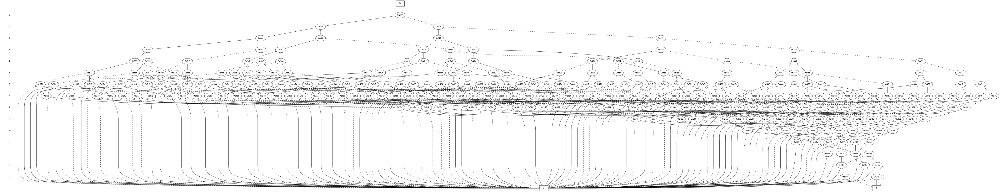

In [22]:
bdd = libcudd.Cudd_BddToAdd(gbm, bdd) 
#para representar bien: 0-1, sin arcos complementados !!cuidado, estropea lo de ZeroRef!!
libBDDlab.write_dd(gbm, bdd, b'tmp.dot')
os.system("dot -Gsize='50x50' -Tpng ./tmp.dot > ./tmp.png")
#display(Image(filename='./tmp.png', width=1000, unconfined=True))
display(Image(filename='./tmp.png',  unconfined=True))
#bdd = libcudd.Cudd_addBddPattern(gbm, bdd) 
#nosirve para arreglar lo anterior, para quit con zeroref

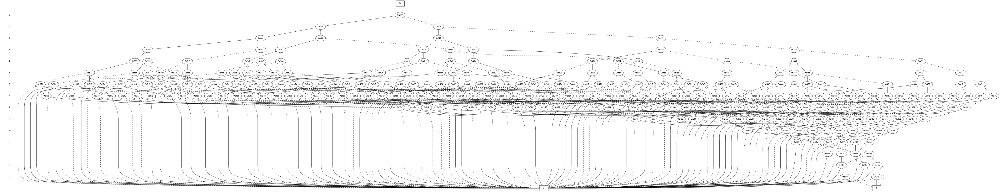

In [23]:
display(Image(filename='./tmp.png'))

mjuajuajuajau

In [26]:
reordenes =[CUDD_REORDER_SAME,
    CUDD_REORDER_NONE,
    CUDD_REORDER_RANDOM,
    CUDD_REORDER_RANDOM_PIVOT,
    CUDD_REORDER_SIFT,
    CUDD_REORDER_SIFT_CONVERGE,
    CUDD_REORDER_SYMM_SIFT,
    CUDD_REORDER_SYMM_SIFT_CONV,
    CUDD_REORDER_WINDOW2,
    CUDD_REORDER_WINDOW3,
    CUDD_REORDER_WINDOW4,
    CUDD_REORDER_WINDOW2_CONV,
    CUDD_REORDER_WINDOW3_CONV,
    CUDD_REORDER_WINDOW4_CONV,
    CUDD_REORDER_GROUP_SIFT,
    CUDD_REORDER_GROUP_SIFT_CONV,
    CUDD_REORDER_ANNEALING,
    CUDD_REORDER_GENETIC,
    CUDD_REORDER_LINEAR,
    CUDD_REORDER_LINEAR_CONVERGE,
    CUDD_REORDER_LAZY_SIFT,
    CUDD_REORDER_EXACT]

In [27]:
for orden in reordenes:
    libcudd.Cudd_ReduceHeap(gbm, orden, 1)
    os.system("echo "+str(orden) +"\n")
    libcudd.cuddHeapProfile(gbm)
    libBDDlab.write_dd(gbm, bdd, b'elgrafo' +str(orden).encode() +b'.dot')
    os.system("dot -Gsize='50x50' -Tpng ./elgrafo" +str(orden)+ ".dot > ./elgrafo" +str(orden)+ ".png")
    

0


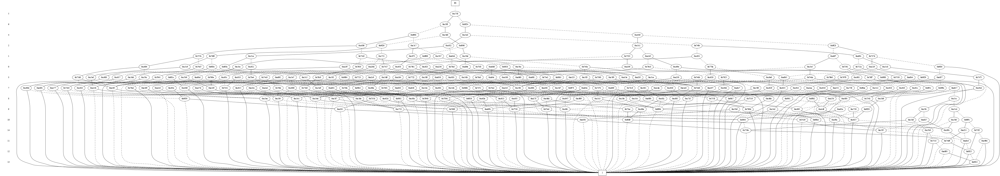

1


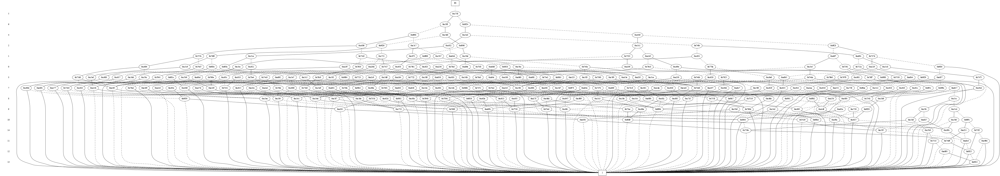

2


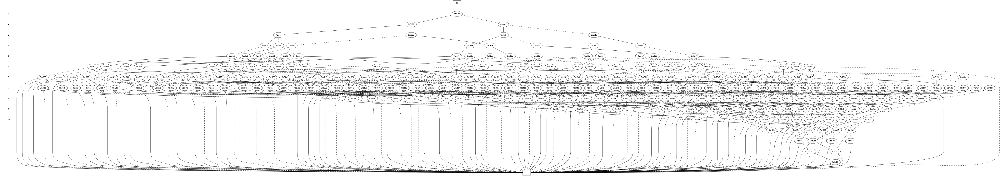

3


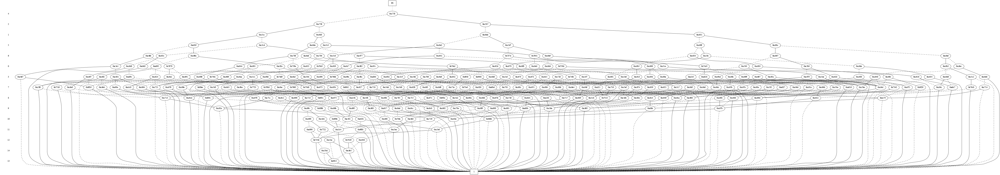

4


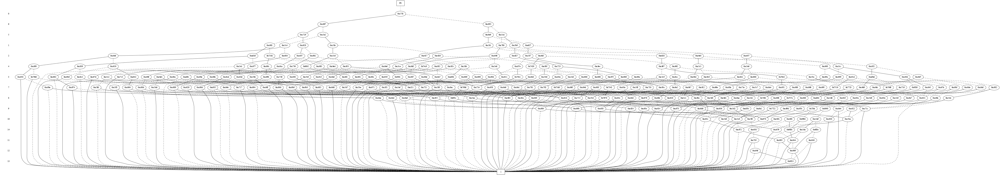

5


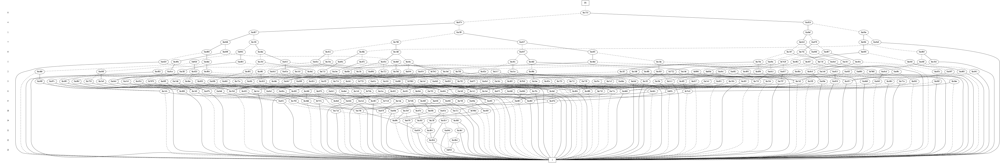

6


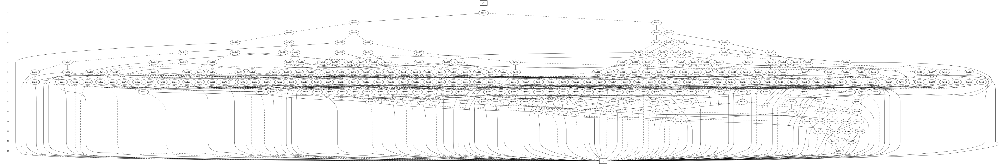

7


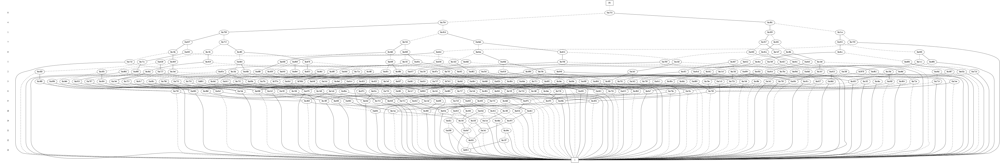

8


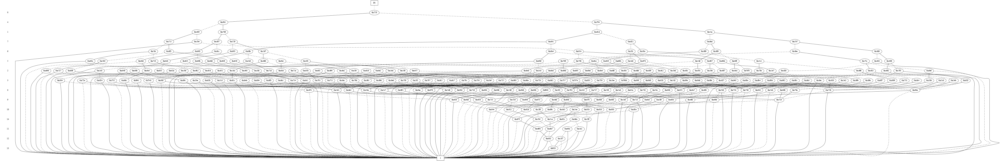

9


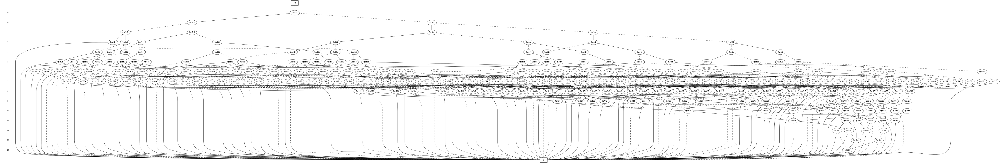

10


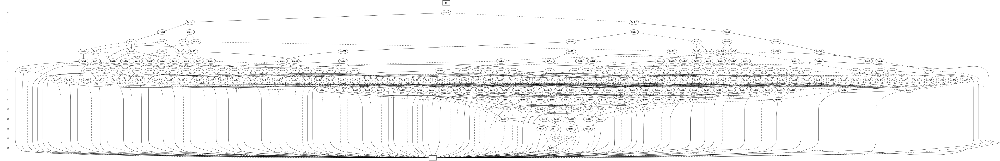

11


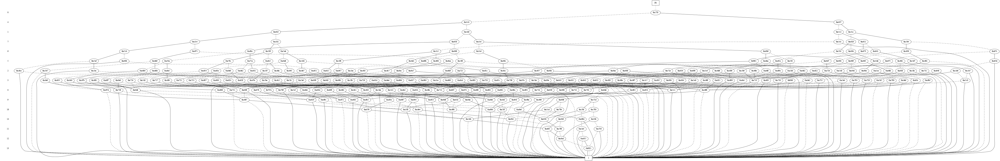

12


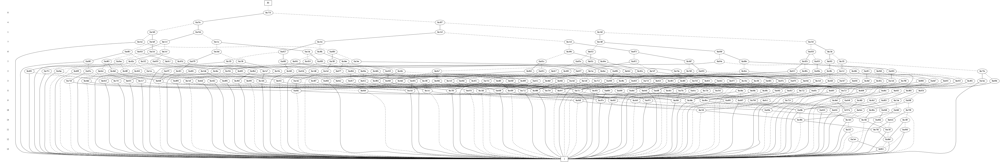

13


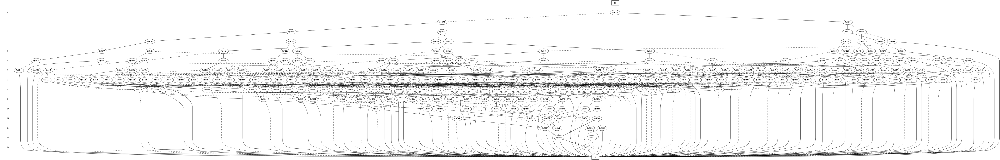

14


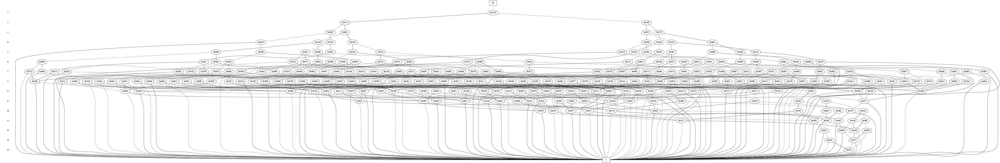

15


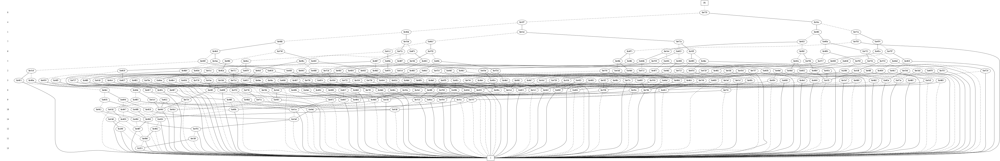

16


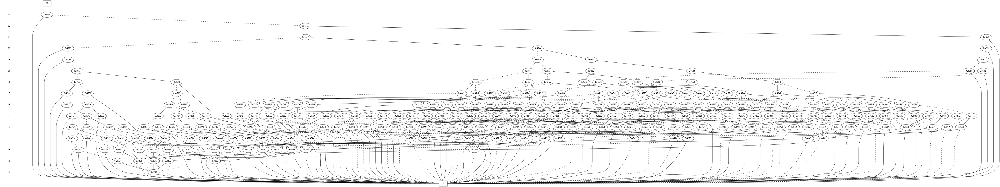

17


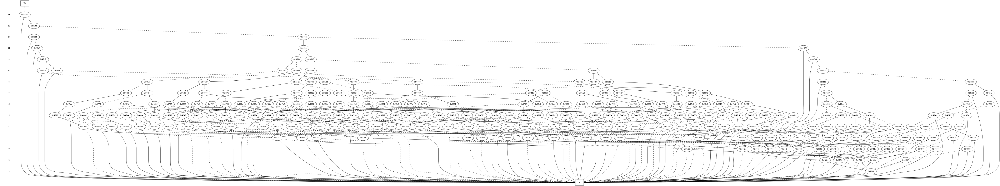

18


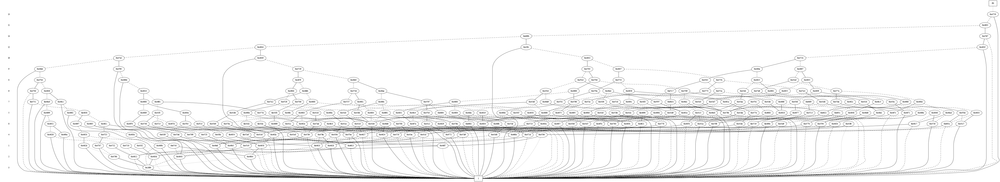

19


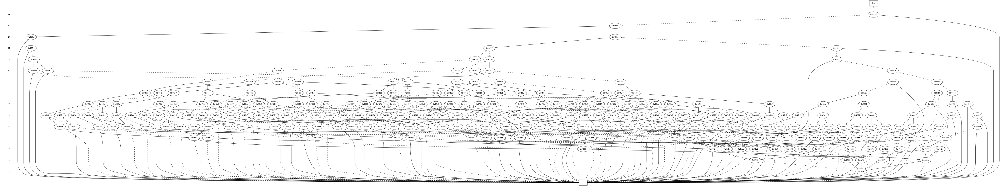

20


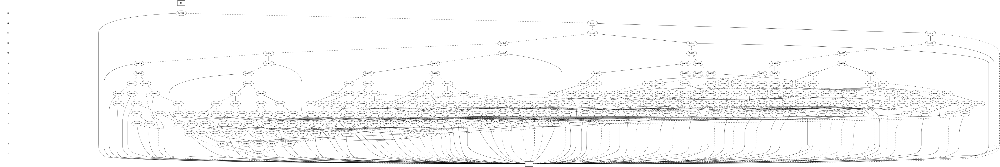

21


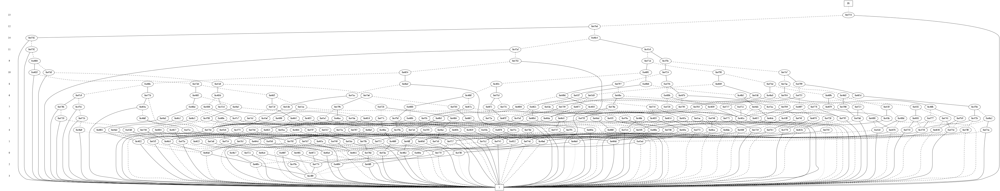

In [28]:
for orden in reordenes:
    print(orden)
    display(Image(filename='./elgrafo' +str(orden)+ '.png', width=1000, unconfined=True))


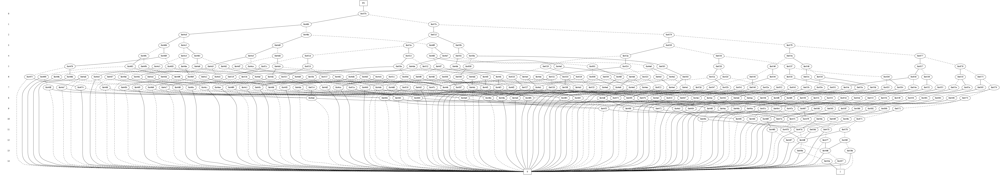

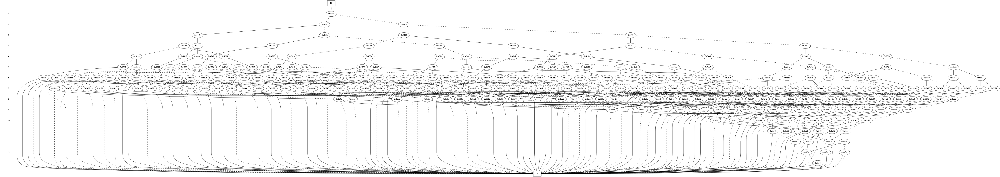

In [11]:
add = libcudd.Cudd_BddToAdd(gbm, bdd) 
libBDDlab.write_dd(gbm, add, b'tmp.dot')
os.system("dot -Gsize='50x50' -Tpng ./tmp.dot > ./tmp.png")
#display(Image(filename='./tmp.png', width=1000, unconfined=True))
display(Image(filename='./tmp.png',  unconfined=True))
libBDDlab.write_dd(gbm, bdd, b'tmp2.dot')
os.system("dot -Gsize='50x50' -Tpng ./tmp2.dot > ./tmp2.png")
#display(Image(filename='./tmp.png', width=1000, unconfined=True))
display(Image(filename='./tmp2.png',  unconfined=True))


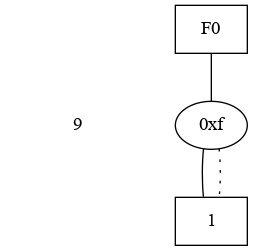

In [29]:
la9 = Cudd_bddIthVar(gbm,9)
libBDDlab.write_dd(gbm, la9, b'tmp.dot')
os.system("dot -Gsize='50x50' -Tpng ./tmp.dot > ./tmp.png")
#display(Image(filename='./tmp.png', width=1000, unconfined=True))
display(Image(filename='./tmp.png',  unconfined=True))

In [26]:
width = 10  # 8bit width
output = [int(x) for x in '{:0{size}b}'.format(48, size=width)]

In [27]:
output

[0, 0, 0, 0, 1, 1, 0, 0, 0, 0]

In [32]:
[[]]*10

[[], [], [], [], [], [], [], [], [], []]